# Random Testing Yahoo stuff

In [1]:
##Ignore this stuff
'''
import pandas as pd
import numpy as np
import yfinance as yf  # to fetch historical price data
import plotly.express as px
import matplotlib.pyplot as plt

# Step 1: Data Collection
import yfinance as yf
dat = yf.Ticker("MSFT")
#(dat.info)
#print(dat.calendar)
#print(dat.analyst_price_targets)
#print(dat.quarterly_income_stmt)
#test = pd.DataFrame(dat.history(period='max'))
#df = pd.DataFrame(dat.option_chain(dat.options[0]).puts)
'''
'''
prices = data['Adj Close']

# Step 2: Calculate Returns
returns = prices.pct_change().dropna()

# Step 3: Calculate Basic Risk Metrics
volatility = returns.std()  # standard deviation of returns
variance = returns.var()
mean_return = returns.mean()

# Example: Calculate Beta relative to S&P 500
benchmark = '^GSPC'
benchmark_data = yf.download(benchmark, start='2020-01-01', end='2023-01-01')
benchmark_returns = benchmark_data['Adj Close'].pct_change().dropna()

cov_matrix = np.cov(returns, benchmark_returns)
cov = cov_matrix[0, 1]
benchmark_var = benchmark_returns.var()
beta = cov / benchmark_var

# Step 4: Calculate Sharpe Ratio (assuming risk-free rate is 0 for simplicity)
sharpe_ratio = mean_return / volatility

print(f"Volatility (Std Dev): {volatility}")
print(f"Variance: {variance}")
print(f"Beta: {beta}")
print(f"Sharpe Ratio: {sharpe_ratio}")
'''
#df.sort_values('lastTradeDate', ascending = False).head(30)
#dat.live()
#test

'\nprices = data[\'Adj Close\']\n\n# Step 2: Calculate Returns\nreturns = prices.pct_change().dropna()\n\n# Step 3: Calculate Basic Risk Metrics\nvolatility = returns.std()  # standard deviation of returns\nvariance = returns.var()\nmean_return = returns.mean()\n\n# Example: Calculate Beta relative to S&P 500\nbenchmark = \'^GSPC\'\nbenchmark_data = yf.download(benchmark, start=\'2020-01-01\', end=\'2023-01-01\')\nbenchmark_returns = benchmark_data[\'Adj Close\'].pct_change().dropna()\n\ncov_matrix = np.cov(returns, benchmark_returns)\ncov = cov_matrix[0, 1]\nbenchmark_var = benchmark_returns.var()\nbeta = cov / benchmark_var\n\n# Step 4: Calculate Sharpe Ratio (assuming risk-free rate is 0 for simplicity)\nsharpe_ratio = mean_return / volatility\n\nprint(f"Volatility (Std Dev): {volatility}")\nprint(f"Variance: {variance}")\nprint(f"Beta: {beta}")\nprint(f"Sharpe Ratio: {sharpe_ratio}")\n'

# Actual Stuff

In [2]:
import pandas as pd
import numpy as np
import yfinance as yf  # to fetch historical price data
import plotly.express as px
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import seaborn as sns
import statsmodels.api as sm
from statsmodels.tsa.stattools import coint
from sklearn.decomposition import PCA
# Step 1: Data Collection
import yfinance as yf

In [3]:
import pandas as pd
import numpy as np
import yfinance as yf  # to fetch historical price data
import plotly.express as px
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import seaborn as sns
import statsmodels.api as sm
from statsmodels.tsa.stattools import coint
from sklearn.decomposition import PCA
# Step 1: Data Collection
import yfinance as yf
class StockPortfolio:
    '''
    This class is to help us manage data regarding a given list of stock tickers
    tickList: list or string of our stock tickers
    tickerList: Dictionary of our ticker names with the yf ticker object
    timePeriod: how far we want to look back on historical data,  must be one of: 1d, 5d, 1mo, 3mo, 6mo, 1y, 2y, 5y, 10y, ytd, max ,,, defaulting to 1 year
    data: A dataframe provided by yahoo finance api that gives us the daily open, close, adjusted close prices, highs and lows, and trading volume
            information for our tickers during a specified time period
    '''
    def __init__(self, tickList):
        self.tickerList = yf.Tickers(tickList).tickers
        self.timePeriod = '1y'
        self.data = yf.download(list(self.tickerList.keys()), period = self.timePeriod, auto_adjust = False) #tickers.tickers is a dictionary of yf ticker objects with keys being the ticker names
    def getSimpleChangeHistory(self, feature: str) -> pd.DataFrame:
        '''
        feature is what feature we want to see the % change in for that day, eg Close Price, Volume, Open Price
        This method calculates the daily closing price pct changes,
        calculated by taking the difference between the kth and (k-1)th day's non-adjusted closing price
        then dividing this difference by the (k-1)th close price to find the pct change after the kth day's market close
        '''
        #data = yf.download(list(self.YfTickers.keys()), period = timePeriod, auto_adjust = False) #tickers.tickers is a dictionary of yf ticker objects with keys being the ticker names
        self.simpleReturn = self.data[(feature,)].pct_change().dropna()
        return self.simpleReturn
    def getLogChangeHistory(self, feature: str) -> pd.DataFrame:
        '''
        This Method calculates the log return for each day, ln(Close Price of Today/close price of yesterday)
        '''
        self.logReturn = np.log(self.data[(feature,)]) - np.log(self.data[(feature,)].shift(1)).dropna()
        return self.logReturn
    def change_timePeriod(self, newTimePeriod: str) -> None:
        '''
        This method changes the time period for the historical data we want to look at
        '''
        self.timePeriod = newTimePeriod
        self.data = yf.download(list(self.tickerList.keys()), period = self.timePeriod, auto_adjust = False) #tickers.tickers is a dictionary of yf ticker objects with keys being the ticker names
        '''
    def simpleReturnVolatility(self) -> float:
        We Actually don't need this
        mean = self.getSimpleReturnHistory().mean()
        std = self.getSimpleReturnHistory().std()
        return std 
    def logReturnVolatility(self) -> float:
        I don't think we need this either
        mean = self.getLogReturnHistory().mean()
        std = self.getLogReturnHistory().std()
        return std
        '''
    def simpleMovingAverage(self,  feature: str, dayWindow: int) -> pd.DataFrame:
        '''
        This method calculates the Simple Moving Average for a specific time window of our non-adjusted Close Prices
        '''
        return self.data[(feature, )].rolling(window = dayWindow).mean()
    def exponentialMovingAverage(self, feature: str, dayWindow: int) -> pd.DataFrame:
        '''
        feature: Any of the features of our stock data, examples: Volume Close Price
        
        This method calculates the exponential moving average for a specific time window of our non-adjusted Close Prices
        This one is more weighted by recent prices, so looking at the difference between the Simple Moving and Exponential moving
        can give some insight into the momentum of the price changes
        '''
        return self.data[(feature, )].ewm(span=dayWindow, adjust=False).mean()
    def extractColumns(self, cols:list,tick:list)->pd.DataFrame:
        newData = self.data.loc[:, (cols, tick)]
        return newData
    def plotMovingAveragesDiff(self,feature: str, timeWindow: int, ticker: str) -> go.Figure:
        '''
        This method creates a figure displaying the moving averages and their difference for a desired time window and ticker
        '''
        df1 = self.simpleMovingAverage(feature,timeWindow)
        df2 = self.exponentialMovingAverage(feature,timeWindow)
        df3 = self.exponentialMovingAverage(feature,timeWindow) - test.simpleMovingAverage(feature,timeWindow)
        newDf = pd.DataFrame()
        newDf['SMA'] = df1[ticker]
        newDf['EMA'] = df2[ticker]
        newDf['Diff'] = df3[ticker]
        fig = go.Figure()

        # Add SMA trace (primary y-axis)
        fig.add_trace(go.Scatter(x=newDf.index, y=newDf['SMA'], mode='lines', name='SMA'))

        # Add EMA trace (primary y-axis)
        fig.add_trace(go.Scatter(x=newDf.index, y=newDf['EMA'], mode='lines', name='EMA'))

        # Add Difference trace (secondary y-axis)
        fig.add_trace(go.Scatter(x=newDf.index, y=newDf['Diff'], mode='lines', name='Difference', yaxis='y2'))

        # Update layout for two y-axes
        diff_min = newDf['Diff'].min()
        diff_max = newDf['Diff'].max()
        padding = (diff_max - diff_min) * 0.1  # 10% padding
        fig.update_layout(
            title=f"Simple Moving Average and Exponential Moving Average of {ticker}'s {feature} over {timeWindow} day window, and Their Difference with Dual Y-Axis for {ticker}",
            xaxis=dict(title='Date'),
            yaxis=dict(title='SMA and EMA'),
            yaxis2=dict(
                title='Difference',
                overlaying='y',
                side='right',
                showgrid=False,
                zeroline=True,
                zerolinecolor='gray',
                range=[diff_min - padding, diff_max + padding]
            ),
            legend=dict(x=0, y=-1)
        )
        return fig
    def MovingAverages(self, feature: str, timeWindow: str) -> pd.DataFrame:
        df1 = self.simpleMovingAverage(feature,timeWindow)
        df2 = self.exponentialMovingAverage(feature,timeWindow)
        df3 = self.exponentialMovingAverage(feature,timeWindow) - self.simpleMovingAverage(feature,timeWindow)
        newDf = pd.DataFrame()
        #combined = pd.concat([df1, df2, df3], axis=1, keys=['SMA', 'EMA', 'Diff'])
        #newDf[('SMA',)] = df1
        #newDf[('EMA',)] = df2
        #newDf[('Diff',)] = df3
        combined = pd.concat([df1, df2, df3], axis=1, keys=['SMA', 'EMA', 'Diff'])
        return combined
    def featureAndTargetSplitter(self, shift: int, sampleSize: int, targetFeature: str, movingAverageWindow: int, ticker ) -> (pd.DataFrame,pd.DataFrame):
        '''
        This method uses all of our data to construct our desired target and feature columns and offset the features by a shifted date to predict that many days in advance
        Sample Size is how many data points we want
        '''
        targetData = self.data[(targetFeature,ticker)].tail(len(self.data[(targetFeature,ticker)]) - movingAverageWindow + 1)
        '''
        feature column construction
        '''
        diff = self.MovingAverages('Close',movingAverageWindow)[('Diff',ticker)].dropna()
        volDiff = self.MovingAverages('Volume',movingAverageWindow)[('Diff',ticker)].dropna()
        logReturn = self.getLogChangeHistory('Close')[ticker].tail(len(self.data[('Close',ticker)]) - movingAverageWindow + 1).dropna()
        volumeData = self.data[('Volume',ticker)].tail(len(self.data[('Volume',ticker)]) - movingAverageWindow + 1)
        closeData = self.data[('Close',ticker)].tail(len(self.data[('Close',ticker)]) - movingAverageWindow + 1)
        openData = self.data[('Open', ticker)].tail(len(self.data[('Open',ticker)]) - movingAverageWindow + 1)
        lowData = self.data[('Low', ticker)].tail(len(self.data[('Low',ticker)]) - movingAverageWindow + 1)
        highData = self.data[('High', ticker)].tail(len(self.data[('High',ticker)]) - movingAverageWindow + 1)
        
        #index = len(closeData)-2
        #testDay = {'Close':closeData.iloc[index],'Volume':volumeData.iloc[index],'LogReturn':logReturn.iloc[index],'MovingAvgDiffClose':diff.iloc[index],'MovingAvgDiffVol':volDiff.iloc[index]}
        '''
        Looking at the target column after the shift, so that we can then look at the previous indices for the feature columns
        '''
        subset_after_shift = targetData.iloc[shift:] 
        sampled_df1 = subset_after_shift.sample(n=sampleSize, random_state=42)
        sampled_df1 = sampled_df1.sort_index()
        sampled_positions = [targetData.index.get_loc(idx) for idx in sampled_df1.index]
        shifted_positions = [pos - shift for pos in sampled_positions]
        valid_shifted_positions = [pos for pos in shifted_positions if pos >= 0]
        selectLogReturn = logReturn.iloc[valid_shifted_positions]
        selectedDiff = diff.iloc[valid_shifted_positions]
        selectVolDiff = volDiff.iloc[valid_shifted_positions]
        selectVolume = volumeData.iloc[valid_shifted_positions]
        selectClose = closeData.iloc[valid_shifted_positions]
        selectOpen = openData.iloc[valid_shifted_positions]
        selectLow = lowData.iloc[valid_shifted_positions]
        selectHigh = highData.iloc[valid_shifted_positions]
        testDf = pd.DataFrame({'LogReturn': selectLogReturn,'MovingAvgDiffClose':selectedDiff, 'MovingAvgDiffVol': selectVolDiff,'Volume':selectVolume,'Close':selectClose,'Open':selectOpen,'Low':selectLow, 'High':selectHigh})
        targetDf = pd.DataFrame({f'Target {targetFeature}':sampled_df1})
        return testDf, targetDf
def standardize(testDf: pd.DataFrame, targetDf: pd.DataFrame) -> (pd.DataFrame, pd.DataFrame):
        '''
        Standardizes 2 pandas dataframes
        '''
        testDf = (testDf - testDf.mean())/testDf.std()
        targetDfmean = targetDf.mean()
        targetDfstd = targetDf.std()
        targetDf = (targetDf - targetDfmean) / targetDfstd
        return testDf, targetDf

In [4]:
testList = ['NVDA']
test3 = StockPortfolio(testList)

[*********************100%***********************]  1 of 1 completed


In [5]:
test3.tickerList['NVDA'].income_stmt

,2025-01-31,2024-01-31,2023-01-31,2022-01-31
Tax Effect Of Unusual Items,0.000000e+00,0.000000e+00,-2.841300e+08,0.000000e+00
Tax Rate For Calcs,1.330000e-01,1.200000e-01,2.100000e-01,1.900000e-02
Normalized EBITDA,8.613700e+10,3.558300e+10,7.339000e+09,1.135100e+10
Total Unusual Items,0.000000e+00,0.000000e+00,-1.353000e+09,0.000000e+00
Total Unusual Items Excluding Goodwill,0.000000e+00,0.000000e+00,-1.353000e+09,0.000000e+00
Net Income From Continuing Operation Net Minority Interest,7.288000e+10,2.976000e+10,4.368000e+09,9.752000e+09
Reconciled Depreciation,1.864000e+09,1.508000e+09,1.543000e+09,1.174000e+09
Reconciled Cost Of Revenue,3.263900e+10,1.662100e+10,1.161800e+10,9.439000e+09
EBITDA,8.613700e+10,3.558300e+10,5.986000e+09,1.135100e+10
EBIT,8.427300e+10,3.407500e+10,4.443000e+09,1.017700e+10


In [6]:
tickerList = [
    "AAPL", "MSFT", "AMZN", "GOOG", "META", "TSLA", "JPM", "V", "NVDA",
    "DIS", "NFLX", "PYPL", "INTC", "CSCO", "KO", "PFE", "MRK", "WMT", "BAC",
    "T", "XOM", "CVX", "ORCL", "IBM", "NKE", "MCD", "GE", "BA", "MMM",
    "CAT", "HON", "UPS", "COST", "SBUX", "CVS", "AMGN", "GILD", "TXN", "QCOM",
    "ADP", "LLY", "SPG", "LRCX", "F", "GM", "BKNG", "ZM", "SNAP",
    "CRM", "NOW", "ABNB", "SHOP", "DOCU", "ROKU", "PLTR", "SPCE", "NIO",
    "JD", "BABA", "TSM", "ASML", "SAP", "EA", "TTWO", "SIRI",
    "LYFT", "UBER", "DELL", "HPQ", "AMD", "MU", "SNPS", "TEAM", "OKTA",
    "TWLO", "NET", "DOCU", "MDB", "ZS", "CRWD", "PANW", "FTNT", "CHKP", "OKTA",
    "SHOP", "ETSY", "VEEV", "ALGN", "ILMN", "ISRG", "DXCM", "REGN", "BIIB"
]

In [7]:
bigTest = StockPortfolio(tickerList)
bigTest.change_timePeriod('5y')
bigTest.data

[*********************100%***********************]  90 of 90 completed
[*********************100%***********************]  90 of 90 completed


Price        Adj Close                                                  \
Ticker            AAPL        ABNB         ADP        ALGN         AMD   
Date                                                                     
2020-12-03  119.676231         NaN  155.292465  511.000000   92.309998   
2020-12-04  119.004539         NaN  157.728882  521.719971   94.040001   
2020-12-07  120.464722         NaN  157.530380  517.710022   94.070000   
2020-12-08  121.078003         NaN  157.494278  515.760010   92.919998   
2020-12-09  118.547012         NaN  156.871643  509.010010   89.830002   
...                ...         ...         ...         ...         ...   
2025-11-25  276.970001  118.559998  256.309998  147.500000  206.130005   
2025-11-26  277.549988  116.739998  254.330002  147.229996  214.240005   
2025-11-28  278.850006  116.989998  255.300003  147.190002  217.529999   
2025-12-01  283.100006  118.800003  255.839996  146.720001  219.759995   
2025-12-02  286.190002  118.500000  257.179993  150.929993  215.240005   

Price                                                                    ...  \
Ticker            AMGN        AMZN         ASML          BA        BABA  ...   
Date                                                                     ...   
2020-12-03  193.856079  159.336502   432.926422  237.199997  253.483124  ...   
2020-12-04  195.820999  158.128998   443.909668  232.710007  253.806000  ...   
2020-12-07  193.463089  157.899994   449.014191  238.169998  250.719467  ...   
2020-12-08  195.590347  158.864502   447.905304  236.570007  252.704346  ...   
2020-12-09  196.367813  155.210007   432.916779  232.059998  250.529526  ...   
...                ...         ...          ...         ...         ...  ...   
2025-11-25  341.109985  229.669998  1003.219971  182.440002  157.009995  ...   
2025-11-26  344.570007  229.160004  1040.969971  186.919998  157.600006  ...   
2025-11-28  345.459991  233.220001  1060.000000  189.000000  157.300003  ...   
2025-12-01  337.489990  233.880005  1087.989990  186.460007  164.259995  ...   
2025-12-02  338.359985  234.419998  1108.780029  205.380005  161.130005  ...   

Price        Volume                                                           \
Ticker         TWLO      TXN      UBER      UPS         V     VEEV       WMT   
Date                                                                           
2020-12-03  2100500  4778600  13122400  2844200   9203300   790400  25725900   
2020-12-04  1413400  3741600  22207900  2766200   5720100   830000  20889300   
2020-12-07  2320500  4645300  13764400  3117200  10624500   885200  18479100   
2020-12-08  2261300  3259900  26167300  3885000   8646200   916600  20716500   
2020-12-09  2779400  5593900  46777900  3327300   6251100  1508600  20139600   
...             ...      ...       ...      ...       ...      ...       ...   
2025-11-25  2224900  7406700  18482200  5840200   5854300  1703400  20212900   
2025-11-26  1262900  7346300  20448700  4685800   4309900  1876500  17783300   
2025-11-28   934400  4018100   9069400  2554800   4586200   738900   9846500   
2025-12-01  2065100  6170800  17517200  4772500   7082300  1664700  17236800   
2025-12-02  2005907  9437700  18914800  4853500   8200800  1075195  18703800   

Price                                     
Ticker           XOM        ZM        ZS  
Date                                      
2020-12-03  27038900   6306700  15382800  
2020-12-04  28723600   4447300   4358600  
2020-12-07  24899400   4427300   2135700  
2020-12-08  32573800   5319400   2852400  
2020-12-09  37824800   8956700   2296000  
...              ...       ...       ...  
2025-11-25  14434600  12606400   3319500  
2025-11-26  11650600   5198500   9823400  
2025-11-28   7240800   1517200   2888200  
2025-12-01  12658100   3309500   3585000  
2025-12-02  14606100   3644400   3206000  

[1255 rows x 540 columns]

In [8]:
test = StockPortfolio(['MSFT', 'AAPL','GOOG','UNH','NVDA','KO','BA','MDT','MCD','SO','NKE'])
test.change_timePeriod('1y')


[*********************100%***********************]  11 of 11 completed
[*********************100%***********************]  11 of 11 completed


In [9]:
cols = ['Close', 'Open', 'Volume']
tic = ['MSFT']
test2 = test.extractColumns(cols,tic)
test2

Price,Close,Open,Volume
Ticker,MSFT,MSFT,MSFT
Date,,,
2024-12-03,431.200012,429.839996,18302000
2024-12-04,437.420013,433.029999,26009400
2024-12-05,442.619995,437.920013,21697800
2024-12-06,443.570007,442.299988,18821000
2024-12-09,446.019989,442.600006,19144400
...,...,...,...
2025-11-25,476.989990,474.070007,28019800
2025-11-26,485.500000,486.309998,25709100


In [10]:
test.change_timePeriod('1y')

[*********************100%***********************]  11 of 11 completed


In [11]:
timeWindow = 60

In [12]:
df = test.data[('Close',)]
fig = px.line(df, x = df.index, y = df['GOOG'], title = f'{df.columns[2]} close price history over {test.timePeriod}')
fig.show()

In [13]:
test.plotMovingAveragesDiff('Close',timeWindow,'GOOG').show()

In [14]:
test.change_timePeriod('1y')
feature = 'Close'
df = test.data[(feature,)]
tick = 'GOOG'

[*********************100%***********************]  11 of 11 completed


In [15]:
fig = px.line(df, x = df.index, y = df[df.columns[df.columns.get_loc(tick)]], title = f'{df.columns[df.columns.get_loc(tick)]} {feature} history over {test.timePeriod}')
fig.show()

In [16]:
test.plotMovingAveragesDiff(feature,60,tick).show()

In [17]:
df = test.getSimpleChangeHistory('Close')
fig = px.line(df, x = df.index, y = df.columns)
fig.show()

In [18]:
df = test.getLogChangeHistory('Close')
fig = px.line(df, x = df.index, y = df.columns, title = f'Daily Volume Change {test.timePeriod}')
fig.update_layout(yaxis_title="Daily Volume Change")
fig.show()

In [19]:
test.change_timePeriod('5y')
df = test.getLogChangeHistory('Close')
df

[*********************100%***********************]  11 of 11 completed


Ticker,AAPL,BA,GOOG,KO,MCD,MDT,MSFT,NKE,NVDA,SO,UNH
Date,,,,,,,,,,,
2020-12-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-12-04,-0.005628,-0.019111,0.000668,0.020070,-0.003647,0.012195,0.000560,0.001678,0.012039,-0.005835,0.003464
2020-12-07,0.012195,0.023192,-0.004666,-0.016099,-0.008817,-0.010951,-0.000327,0.011307,0.003571,0.003408,-0.005819
2020-12-08,0.005078,-0.006741,-0.000511,0.003579,-0.002396,-0.012780,0.007994,0.002663,-0.019050,-0.011896,0.000000
2020-12-09,-0.021125,-0.019248,-0.019109,0.002817,0.001439,0.015795,-0.019682,-0.002375,-0.031908,-0.003778,-0.009967
...,...,...,...,...,...,...,...,...,...,...,...
2025-11-25,0.003798,0.018365,0.016104,0.000276,0.018039,0.020619,0.006288,0.027866,-0.026252,0.001681,0.022408
2025-11-26,0.002092,0.024259,-0.010436,0.003712,0.006262,-0.003137,0.017684,0.010156,0.013628,0.010583,0.010458
2025-11-28,0.004673,0.011066,-0.000500,0.003288,-0.001858,0.002948,0.013320,0.004653,-0.018250,0.009705,0.000182


In [20]:
bigTest.change_timePeriod('5y')

[*********************100%***********************]  90 of 90 completed


In [21]:
df = bigTest.getLogChangeHistory('Close')
df

Ticker,AAPL,ABNB,ADP,ALGN,AMD,AMGN,AMZN,ASML,BA,BABA,...,TWLO,TXN,UBER,UPS,V,VEEV,WMT,XOM,ZM,ZS
Date,,,,,,,,,,,,,,,,,,,,,
2020-12-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-12-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-12-07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-12-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-12-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-11-25,0.003798,0.035631,0.024527,0.026588,-0.042364,0.020166,0.014870,0.015470,0.018365,-0.023416,...,0.032818,0.003158,0.000000,0.010420,0.015757,0.017701,0.027861,-0.012669,0.093921,0.032911
2025-11-26,0.002092,-0.015470,-0.007755,-0.001832,0.038590,0.010092,-0.002223,0.036938,0.024259,0.003751,...,-0.011974,0.021889,0.023266,0.011882,-0.002214,0.002996,0.019436,0.002268,-0.022370,-0.139639
2025-11-28,0.004673,0.002139,0.003807,-0.000272,0.015240,0.002580,0.017562,0.018116,0.011066,-0.001905,...,0.020881,0.017505,0.021710,0.001254,0.001945,-0.001580,0.012841,0.009970,0.006258,-0.001867


In [22]:
df = bigTest.getLogChangeHistory('Close')
fig = px.line(df, x = df.index, y = df.columns, title = f'Daily Volume Change {test.timePeriod}')
fig.update_layout(yaxis_title="Daily Volume Change")
fig.show()

In [23]:
returns = test.getLogChangeHistory('Close').dropna()
summary_stats = returns.describe().T
summary_stats['skew'] = returns.skew()
summary_stats['kurtosis'] = returns.kurtosis()
corr_matrix = returns.corr()
cov_matrix = returns.cov()
corr_matrix

Ticker,AAPL,BA,GOOG,KO,MCD,MDT,MSFT,NKE,NVDA,SO,UNH
Ticker,,,,,,,,,,,
AAPL,1.000000,0.378347,0.577002,0.266438,0.320613,0.317513,0.633087,0.443308,0.517227,0.181281,0.140540
BA,0.378347,1.000000,0.319020,0.141713,0.240957,0.259356,0.310982,0.346082,0.346804,0.086645,0.092949
GOOG,0.577002,0.319020,1.000000,0.141050,0.219620,0.248094,0.649497,0.359605,0.527589,0.089086,0.121979
KO,0.266438,0.141713,0.141050,1.000000,0.537705,0.393119,0.204267,0.241362,0.013921,0.521708,0.207871
MCD,0.320613,0.240957,0.219620,0.537705,1.000000,0.367647,0.259143,0.271632,0.125052,0.413915,0.242554
MDT,0.317513,0.259356,0.248094,0.393119,0.367647,1.000000,0.258915,0.265649,0.135943,0.358264,0.197573
MSFT,0.633087,0.310982,0.649497,0.204267,0.259143,0.258915,1.000000,0.366399,0.631233,0.121610,0.149993
NKE,0.443308,0.346082,0.359605,0.241362,0.271632,0.265649,0.366399,1.000000,0.312021,0.178066,0.058584
NVDA,0.517227,0.346804,0.527589,0.013921,0.125052,0.135943,0.631233,0.312021,1.000000,-0.047572,0.065920


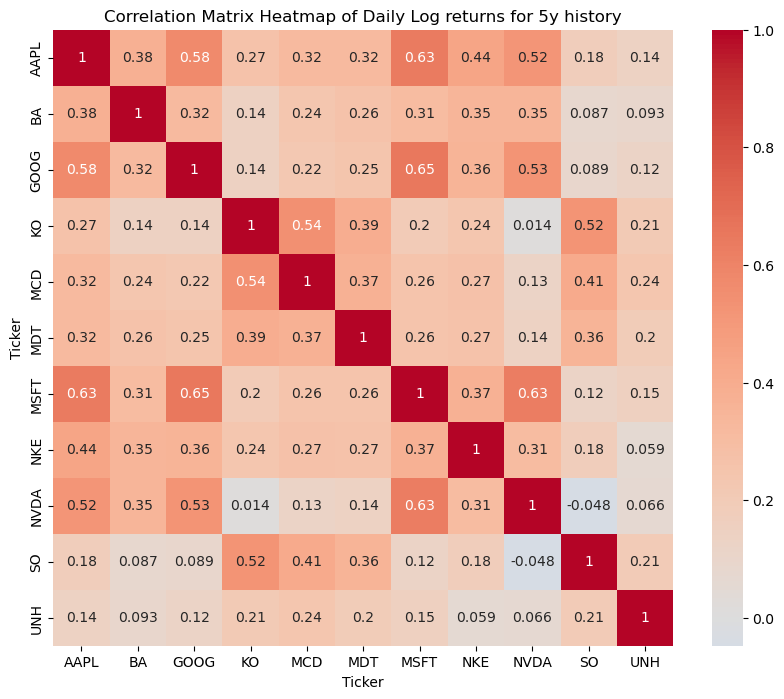

In [24]:
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', center=0)
plt.title(f'Correlation Matrix Heatmap of Daily Log returns for {test.timePeriod} history' )
plt.show()

In [25]:
returns = test.getLogChangeHistory('Volume').dropna()
summary_stats = returns.describe().T
summary_stats['skew'] = returns.skew()
summary_stats['kurtosis'] = returns.kurtosis()
corr_matrix = returns.corr()
cov_matrix = returns.cov()
corr_matrix

Ticker,AAPL,BA,GOOG,KO,MCD,MDT,MSFT,NKE,NVDA,SO,UNH
Ticker,,,,,,,,,,,
AAPL,1.000000,0.184385,0.521257,0.503674,0.418855,0.358404,0.560236,0.364618,0.340011,0.366406,0.375929
BA,0.184385,1.000000,0.212325,0.189950,0.168960,0.126449,0.246562,0.148750,0.173242,0.157401,0.179856
GOOG,0.521257,0.212325,1.000000,0.466039,0.406813,0.316623,0.601323,0.352286,0.365721,0.388649,0.366482
KO,0.503674,0.189950,0.466039,1.000000,0.513074,0.445139,0.529582,0.400514,0.291051,0.487247,0.424178
MCD,0.418855,0.168960,0.406813,0.513074,1.000000,0.352291,0.443770,0.376214,0.258948,0.425654,0.377447
MDT,0.358404,0.126449,0.316623,0.445139,0.352291,1.000000,0.337450,0.278442,0.220021,0.316800,0.337656
MSFT,0.560236,0.246562,0.601323,0.529582,0.443770,0.337450,1.000000,0.373634,0.391659,0.395881,0.407272
NKE,0.364618,0.148750,0.352286,0.400514,0.376214,0.278442,0.373634,1.000000,0.226612,0.356418,0.345795
NVDA,0.340011,0.173242,0.365721,0.291051,0.258948,0.220021,0.391659,0.226612,1.000000,0.275569,0.225667


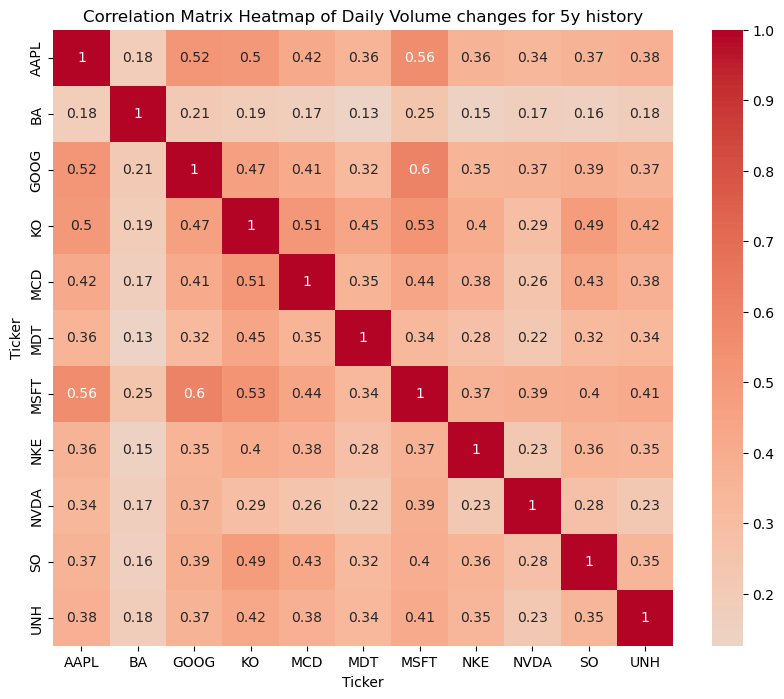

In [26]:
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', center=0)
plt.title(f'Correlation Matrix Heatmap of Daily Volume changes for {test.timePeriod} history' )
plt.show()

In [27]:
'''
fig = px.scatter_matrix(returns)
fig.update_traces(showupperhalf=False,diagonal_visible=False)
fig.update_layout(
    title=dict(text='Pair Plot of Returns'),
    width=1000,
    height=1000,
)
fig.show()
'''

"\nfig = px.scatter_matrix(returns)\nfig.update_traces(showupperhalf=False,diagonal_visible=False)\nfig.update_layout(\n    title=dict(text='Pair Plot of Returns'),\n    width=1000,\n    height=1000,\n)\nfig.show()\n"

In [28]:
test.change_timePeriod('1y')
returns = test.MovingAverages('Close',70)[('Diff',)]
summary_stats = returns.describe().T
summary_stats['skew'] = returns.skew()
summary_stats['kurtosis'] = returns.kurtosis()
corr_matrix = returns.corr()
cov_matrix = returns.cov()
corr_matrix

[*********************100%***********************]  11 of 11 completed


Ticker,AAPL,BA,GOOG,KO,MCD,MDT,MSFT,NKE,NVDA,SO,UNH
Ticker,,,,,,,,,,,
AAPL,1.000000,0.050403,0.902093,-0.575775,-0.276722,0.566434,-0.022271,0.456299,0.261576,-0.386829,0.339283
BA,0.050403,1.000000,0.250378,-0.642797,-0.517584,0.012036,0.948402,0.604299,0.897668,-0.329444,-0.788095
GOOG,0.902093,0.250378,1.000000,-0.755866,-0.439416,0.305393,0.227063,0.345625,0.397629,-0.702719,0.043290
KO,-0.575775,-0.642797,-0.755866,1.000000,0.537145,-0.042335,-0.607579,-0.449899,-0.655644,0.609896,0.248759
MCD,-0.276722,-0.517584,-0.439416,0.537145,1.000000,-0.132692,-0.703675,-0.425012,-0.749974,0.406191,0.499518
MDT,0.566434,0.012036,0.305393,-0.042335,-0.132692,1.000000,-0.094622,0.740321,0.261898,0.349772,0.325085
MSFT,-0.022271,0.948402,0.227063,-0.607579,-0.703675,-0.094622,1.000000,0.493056,0.903050,-0.408892,-0.875118
NKE,0.456299,0.604299,0.345625,-0.449899,-0.425012,0.740321,0.493056,1.000000,0.783914,0.161250,-0.175928
NVDA,0.261576,0.897668,0.397629,-0.655644,-0.749974,0.261898,0.903050,0.783914,1.000000,-0.269936,-0.661268


In [29]:
bigTest.change_timePeriod('5y')
big_returns = bigTest.MovingAverages('Volume',70)[('Diff',)]
big_summary_stats = big_returns.describe().T
big_summary_stats['skew'] = big_returns.skew()
big_summary_stats['kurtosis'] = big_returns.kurtosis()
big_corr_matrix = big_returns.corr()
big_cov_matrix = big_returns.cov()
big_corr_matrix

[*********************100%***********************]  90 of 90 completed


Ticker,AAPL,ABNB,ADP,ALGN,AMD,AMGN,AMZN,ASML,BA,BABA,...,TWLO,TXN,UBER,UPS,V,VEEV,WMT,XOM,ZM,ZS
Ticker,,,,,,,,,,,,,,,,,,,,,
AAPL,1.000000,-0.212390,0.385150,0.237305,0.177229,0.160019,0.371634,0.075685,-0.037018,-0.030196,...,0.010893,0.324325,0.017853,0.223899,0.371357,0.298134,0.268997,0.167340,0.160666,-0.053198
ABNB,-0.212390,1.000000,-0.154393,0.036069,-0.002772,0.056470,0.023840,-0.018794,0.525812,-0.119902,...,0.106183,0.025253,-0.071300,-0.014150,-0.128570,-0.016776,0.015725,-0.097613,-0.048141,0.795791
ADP,0.385150,-0.154393,1.000000,0.280907,0.333829,0.366132,0.208534,0.182842,0.086265,-0.047702,...,0.123358,0.444260,0.137368,0.241309,0.254858,0.273172,0.272117,0.418355,0.132393,0.081178
ALGN,0.237305,0.036069,0.280907,1.000000,0.176489,0.006849,0.480877,0.351641,0.141375,0.089784,...,0.351851,0.486158,0.194981,0.469107,0.242940,0.056640,0.223230,0.329884,0.033208,-0.029897
AMD,0.177229,-0.002772,0.333829,0.176489,1.000000,0.252720,0.430506,0.220520,0.109567,0.090925,...,0.264659,0.286818,0.256608,0.302920,0.224761,0.036883,0.014438,0.249579,0.119189,-0.008123
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VEEV,0.298134,-0.016776,0.273172,0.056640,0.036883,0.328828,0.158646,-0.208702,0.032141,-0.008194,...,0.068376,0.090815,0.408728,-0.151750,0.145978,1.000000,0.417828,0.355018,0.548512,0.274675
WMT,0.268997,0.015725,0.272117,0.223230,0.014438,0.170550,0.173062,-0.214853,0.128476,0.112323,...,0.149823,0.190567,0.182679,0.082167,0.337014,0.417828,1.000000,0.088188,0.493082,0.193646
XOM,0.167340,-0.097613,0.418355,0.329884,0.249579,0.358018,0.311363,0.159556,0.124900,0.100437,...,0.085057,0.385303,0.243563,0.092233,0.211592,0.355018,0.088188,1.000000,0.113208,0.064005


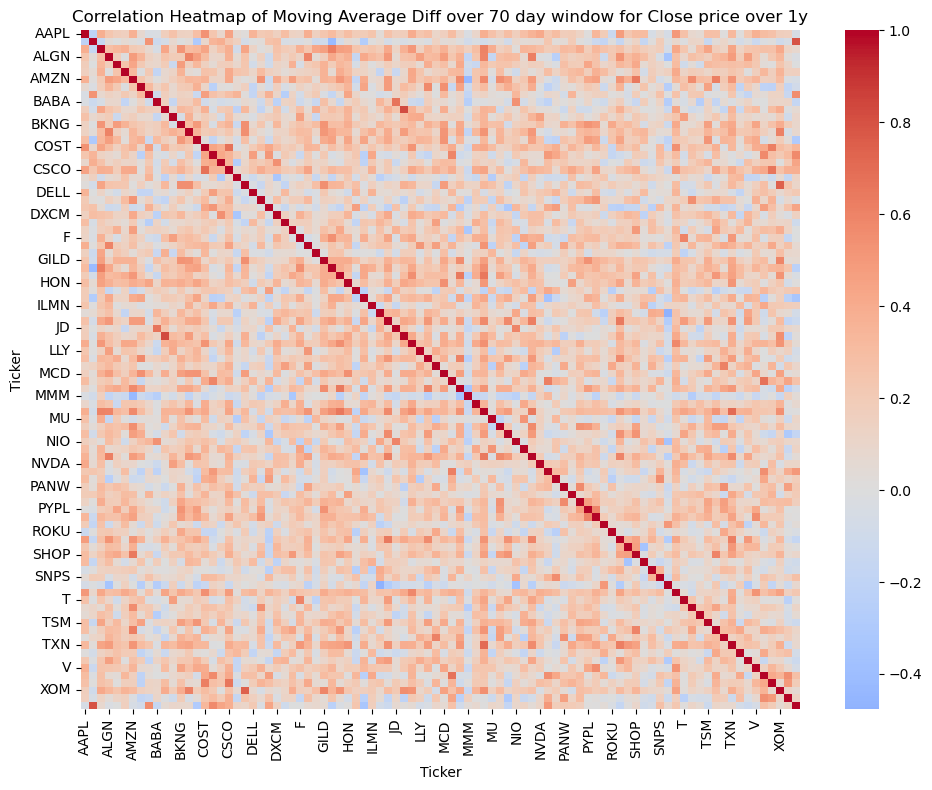

In [30]:
plt.figure(figsize=(10, 8))
sns.heatmap(big_corr_matrix, annot=False, cmap='coolwarm', center=0)
plt.title(f'Correlation Heatmap of Moving Average Diff over 70 day window for Close price over {test.timePeriod}' )
plt.tight_layout()
plt.show()

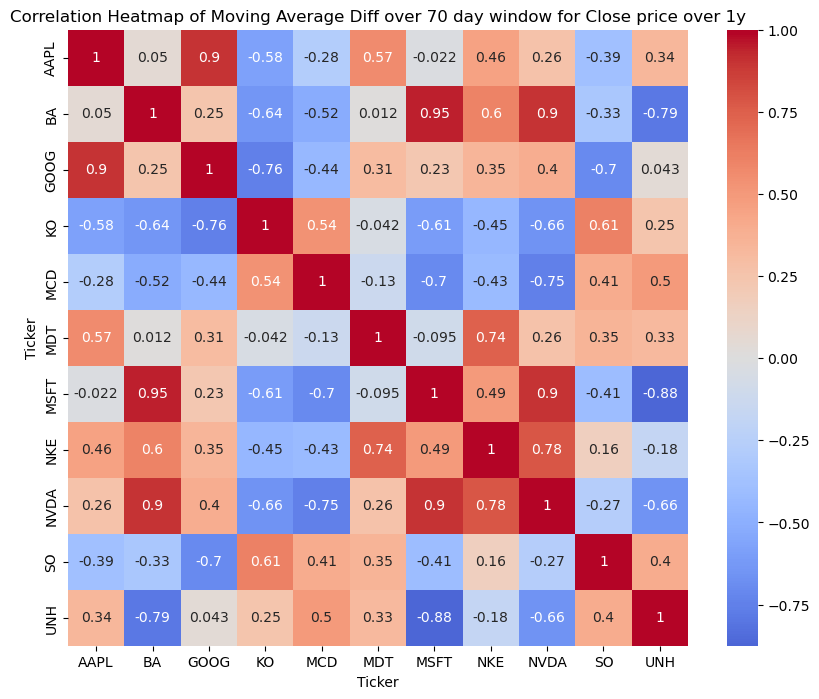

In [31]:
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', center=0)
plt.title(f'Correlation Heatmap of Moving Average Diff over 70 day window for Close price over {test.timePeriod}' )
plt.show()

In [32]:
test.MovingAverages('Close',70)[('Diff',)]

Ticker,AAPL,BA,GOOG,KO,MCD,MDT,MSFT,NKE,NVDA,SO,UNH
Date,,,,,,,,,,,
2024-12-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-12-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-12-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-12-06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-12-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
2025-11-25,1.274797,-6.371933,2.889360,0.786283,-1.206183,-0.053018,-4.651243,-2.070273,-1.035792,-0.555585,-3.007341
2025-11-26,1.263593,-6.391577,3.000660,0.845351,-1.000924,0.023703,-4.852651,-1.976119,-1.160422,-0.573862,-3.488412
2025-11-28,1.186844,-6.357609,3.026346,0.913124,-0.779377,0.143911,-5.006095,-1.884258,-1.332088,-0.567108,-4.028205


In [33]:
test.change_timePeriod('1y')
returns = test.MovingAverages('Volume',70)[('Diff',)]
summary_stats = returns.describe().T
summary_stats['skew'] = returns.skew()
summary_stats['kurtosis'] = returns.kurtosis()
corr_matrix = returns.corr()
cov_matrix = returns.cov()
corr_matrix

[*********************100%***********************]  11 of 11 completed


Ticker,AAPL,BA,GOOG,KO,MCD,MDT,MSFT,NKE,NVDA,SO,UNH
Ticker,,,,,,,,,,,
AAPL,1.000000,0.493289,0.099945,0.300999,0.392994,-0.275847,0.768933,0.469291,0.504711,-0.374149,-0.100655
BA,0.493289,1.000000,0.485854,0.129813,0.189517,-0.017215,0.348197,0.703501,0.377797,0.041129,-0.101156
GOOG,0.099945,0.485854,1.000000,0.182852,0.172352,0.228802,0.005484,0.480169,-0.037967,0.363095,0.362945
KO,0.300999,0.129813,0.182852,1.000000,0.734006,0.219031,0.395630,0.616196,0.467529,0.124493,-0.520025
MCD,0.392994,0.189517,0.172352,0.734006,1.000000,0.179697,0.409301,0.603462,0.276550,0.288640,-0.635108
MDT,-0.275847,-0.017215,0.228802,0.219031,0.179697,1.000000,-0.070482,0.193182,0.191885,0.561055,-0.289080
MSFT,0.768933,0.348197,0.005484,0.395630,0.409301,-0.070482,1.000000,0.391090,0.790192,-0.142270,-0.257771
NKE,0.469291,0.703501,0.480169,0.616196,0.603462,0.193182,0.391090,1.000000,0.484673,0.155301,-0.414502
NVDA,0.504711,0.377797,-0.037967,0.467529,0.276550,0.191885,0.790192,0.484673,1.000000,0.046724,-0.466218


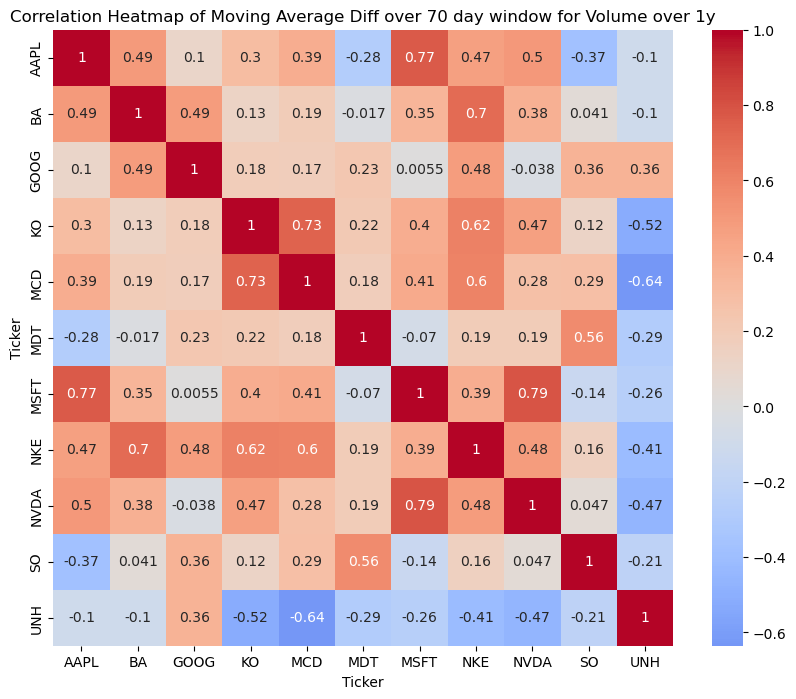

In [34]:
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', center=0)
plt.title(f'Correlation Heatmap of Moving Average Diff over 70 day window for Volume over {test.timePeriod}' )
plt.show()

In [35]:
df = bigTest.MovingAverages('Close',70)[('Diff',)]
fig = px.line(df, x = df.index, y = df.columns, title = f'Moving Average diff over 70 day window for Close Price over {test.timePeriod}')
fig.show()

In [36]:
df = bigTest.MovingAverages('Volume',70)[('Diff',)]
fig = px.line(df, x = df.index, y = df.columns, title = f'Moving Average diff over 70 day window for Volume over {bigTest.timePeriod}')
fig.show()

# Random Stuff I'm testing

In [37]:
bigTest.change_timePeriod('5y')
movingAverageWindow = 70
ticker = 'KO'
diff = test.MovingAverages('Close',movingAverageWindow)[('Diff',ticker)].dropna()
diff

[*********************100%***********************]  90 of 90 completed


Date
2025-03-17    1.368280
2025-03-18    1.363709
2025-03-19    1.336805
2025-03-20    1.323928
2025-03-21    1.288670
                ...   
2025-11-25    0.786283
2025-11-26    0.845351
2025-11-28    0.913124
2025-12-01    0.961199
2025-12-02    0.982058
Name: (Diff, KO), Length: 181, dtype: float64

In [63]:
    dayshift = 5
    diff = bigTest.MovingAverages('Close',movingAverageWindow)[('Diff',ticker)].dropna()
    volDiff = bigTest.MovingAverages('Volume',movingAverageWindow)[('Diff',ticker)].dropna()
    logReturn = bigTest.getLogChangeHistory('Close')[ticker].tail(len(bigTest.data[('Close',ticker)]) - movingAverageWindow + 1).dropna()
    volumeData = bigTest.data[('Volume',ticker)].tail(len(bigTest.data[('Volume',ticker)]) - movingAverageWindow + 1)
    closeData = bigTest.data[('Close',ticker)].tail(len(bigTest.data[('Close',ticker)]) - movingAverageWindow + 1)
    openData = bigTest.data[('Open', ticker)].tail(len(bigTest.data[('Open',ticker)]) - movingAverageWindow + 1)
    lowData = bigTest.data[('Low', ticker)].tail(len(bigTest.data[('Low',ticker)]) - movingAverageWindow + 1)
    highData = bigTest.data[('High', ticker)].tail(len(bigTest.data[('High',ticker)]) - movingAverageWindow + 1)
    testDay = [diff.tail(dayshift).iloc[0],volDiff.tail(dayshift).iloc[0],logReturn.tail(dayshift).iloc[0],volumeData.tail(dayshift).iloc[0],closeData.tail(dayshift).iloc[0],openData.tail(dayshift).iloc[0],
               lowData.tail(dayshift).iloc[0],highData.tail(dayshift).iloc[0]]
    nonShiftedTestDf = pd.DataFrame({'LogReturn': logReturn,'MovingAvgDiffClose':diff, 'MovingAvgDiffVol': volDiff,'Volume':volumeData,
                                     'Close':closeData,'Open':openData,'Low':lowData, 'High':highData})
nonShiftedTestDf

,LogReturn,MovingAvgDiffClose,MovingAvgDiffVol,Volume,Close,Open,Low,High
Date,,,,,,,,
2021-03-16,0.003716,-0.133261,-76792.768787,14214200,51.220001,51.200001,51.040001,51.520000
2021-03-17,0.000390,-0.100079,-84998.807493,17502700,51.240002,51.250000,51.150002,51.619999
2021-03-18,-0.013162,-0.061227,-74563.569455,18007300,50.570000,51.060001,50.490002,51.189999
2021-03-19,0.004735,-0.031104,600238.341958,67845700,50.810001,50.459999,50.169998,51.080002
2021-03-22,0.003732,0.004400,488784.585847,17911400,51.000000,50.320000,50.320000,51.080002
...,...,...,...,...,...,...,...,...
2025-11-25,0.000276,0.788823,-3293.600583,17451200,72.610001,72.800003,72.139999,72.930000
2025-11-26,0.003712,0.847820,-112443.821090,11795100,72.879997,72.599998,72.389999,73.089996
2025-11-28,0.003288,0.915523,-225978.160134,7423000,73.120003,73.000000,72.760002,73.230003


In [64]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import accuracy_score

In [557]:
testDf,targetDf = bigTest.featureAndTargetSplitter(21, 350, 'Open',movingAverageWindow, ticker )
np.array(testDay)

array([ 7.88823227e-01, -3.29360058e+03,  2.75540951e-04,  1.74512000e+07,
        7.26100006e+01,  7.28000031e+01,  7.21399994e+01,  7.29300003e+01])

In [558]:
np.array(list(testDf.mean()))

array([ 5.82104752e-05,  5.02287177e-02, -4.65525353e+04,  1.50051394e+07,
        6.19490571e+01,  6.19864857e+01,  6.15228857e+01,  6.23762000e+01])

In [559]:
testDay = (testDay - np.array(list(testDf.mean())))/np.array(list(testDf.std()))
testDay

array([ 7.68039878e+01, -4.80967385e+03,  7.00423801e-02,  3.80518492e-01,
        2.18595470e+00,  2.21719244e+00,  2.19622732e+00,  2.14516439e+00])

In [560]:
targetDf.tail(77)

,Target Open
Date,
2024-10-08,69.040001
2024-10-16,70.089996
2024-10-24,67.650002
2024-10-30,65.510002
2024-11-01,65.470001
...,...
2025-11-18,70.989998
2025-11-19,71.199997
2025-11-20,70.949997


In [561]:
testDay

array([ 7.68039878e+01, -4.80967385e+03,  7.00423801e-02,  3.80518492e-01,
        2.18595470e+00,  2.21719244e+00,  2.19622732e+00,  2.14516439e+00])

In [562]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import accuracy_score

standTest,standTarget = standardize(testDf,targetDf)
X_train, X_test, y_train, y_test = train_test_split(standTest, standTarget, test_size=0.2)

# Initialize the model
model = LinearRegression()
X_train = X_train.sort_index()
y_train = y_train.sort_index()
X_test = X_test.sort_index()
y_test = y_test.sort_index()
# Train the model

model.fit(X_train, y_train)

# Predict on the test data
y_pred = model.predict(X_test)
# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Squared Error: {mse:.2f}")
print(f"R^2 Score: {r2:.2f}")

Mean Squared Error: 0.32
R^2 Score: 0.72


In [563]:
y_test*targetDf.std().iloc[0]+targetDf.mean().iloc[0]

,Target Open
Date,
2021-04-19,54.000000
2021-07-09,54.250000
2021-08-19,56.060001
2021-08-31,56.160000
2021-09-08,55.610001
...,...
2025-08-04,68.720001
2025-10-13,66.230003
2025-10-28,70.050003


In [564]:
y_train*targetDf.std().iloc[0]+targetDf.mean().iloc[0]

,Target Open
Date,
2021-04-20,53.840000
2021-04-23,54.400002
2021-04-29,53.540001
2021-05-03,54.270000
2021-05-18,54.389999
...,...
2025-11-13,71.419998
2025-11-18,70.989998
2025-11-20,70.949997


In [565]:
X_test*testDf.std()+testDf.mean()

,LogReturn,MovingAvgDiffClose,MovingAvgDiffVol,Volume,Close,Open,Low,High
Date,,,,,,,,
2021-03-18,-0.013162,-0.061227,-74563.569455,18007300.0,50.570000,51.060001,50.490002,51.189999
2021-06-09,-0.003060,0.363467,-274369.104119,9838800.0,55.480000,55.750000,55.480000,55.919998
2021-07-21,0.012814,-0.246898,772548.622786,20918200.0,56.549999,57.330002,56.430000,57.560001
2021-08-02,-0.002634,-0.093494,234475.931534,9778000.0,56.880001,57.200001,56.709999,57.240002
2021-08-09,0.000177,-0.067902,-255879.375390,8859900.0,56.650002,56.799999,56.430000,56.880001
...,...,...,...,...,...,...,...,...
2025-07-03,0.006186,-0.646920,-66689.437564,9440500.0,71.349998,71.040001,70.449997,71.400002
2025-09-12,-0.009062,-0.291616,288719.876754,18712400.0,67.010002,67.599998,66.940002,67.720001
2025-09-29,0.005618,-0.380235,17859.906034,14818500.0,66.040001,65.669998,65.349998,66.099998


In [566]:
allPred = model.predict(standTest)

In [567]:
targetDf.mean().iloc[0]

np.float64(62.1716000693185)

In [568]:
allPred[len(allPred)- 1]*targetDf.std().iloc[0]+targetDf.mean().iloc[0]

array([69.84571304])

In [569]:
mse = mean_squared_error(standTarget, allPred)
r2 = r2_score(standTarget, allPred)
mse,r2

(0.2517276982178832, 0.7475510189792005)

In [570]:
newTestarray = np.array(y_pred)

In [571]:
(newTestarray*targetDf.std().iloc[0]+targetDf.mean().iloc[0])[len(newTestarray)-1]

array([72.6311367])

In [572]:
X_test

,LogReturn,MovingAvgDiffClose,MovingAvgDiffVol,Volume,Close,Open,Low,High
Date,,,,,,,,
2021-03-18,-1.287284,-0.162758,-0.042145,0.467028,-2.333199,-2.240355,-2.282232,-2.273706
2021-06-09,-0.303581,0.457418,-0.342770,-0.803695,-1.326437,-1.278723,-1.250015,-1.312287
2021-07-21,1.242043,-0.433890,1.232410,0.919858,-1.107040,-0.954761,-1.053500,-0.978940
2021-08-02,-0.262110,-0.209876,0.422832,-0.813154,-1.039376,-0.981416,-0.995581,-1.043983
2021-08-09,0.011526,-0.172505,-0.314951,-0.955977,-1.086536,-1.063432,-1.053500,-1.117157
...,...,...,...,...,...,...,...,...
2025-07-03,0.596659,-1.018037,-0.030298,-0.865656,1.927600,1.856323,1.846638,1.834177
2025-09-12,-0.888052,-0.499191,0.504447,0.576716,1.037713,1.150989,1.120570,1.086180
2025-09-29,0.541415,-0.628601,0.096914,-0.029034,0.838820,0.755264,0.791666,0.756899


In [573]:
y_test

,Target Open
Date,
2021-04-19,-1.640917
2021-07-09,-1.590716
2021-08-19,-1.227254
2021-08-31,-1.207174
2021-09-08,-1.317617
...,...
2025-08-04,1.314967
2025-10-13,0.814957
2025-10-28,1.582041


In [574]:
testDay = np.array(testDay).reshape(-1,8)
testDay

array([[ 7.68039878e+01, -4.80967385e+03,  7.00423801e-02,
         3.80518492e-01,  2.18595470e+00,  2.21719244e+00,
         2.19622732e+00,  2.14516439e+00]])

In [581]:
models = {
    'Random Forest': RandomForestRegressor(random_state=42),
    #'Gradient Boosting': GradientBoostingRegressor(random_state=42),
    #'Support Vector Regression': SVR()
}
accuracy_results = {model_name: [] for model_name in models}
Nov18_results = {model_name: [] for model_name in models}
modelNov18predAvg = []
random_states = [0,5,15,25, 50,75,100,125,150,175, 200,225,250,275, 300]
for rs in random_states:
    X_train, X_test, y_train, y_test = train_test_split(standTest, standTarget, test_size=0.2, random_state=rs)
    for name, model in models.items():
        X_train = X_train.sort_index()
        y_train = y_train.sort_index()
        X_test = X_test.sort_index()
        y_test = y_test.sort_index()
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        mse = mean_squared_error(y_test, y_pred)
        r2 = r2_score(y_test, y_pred)
        if name == 'Support Vector Regression':
            day40AfterNov25 = model.predict(testDay)*targetDf.std()+targetDf.mean()
            modelNov18predAvg.append(day40AfterNov25)
        #print(f"{name}: Mean Squared Error = {mse:.2f}, R^2 Score = {r2:.2f}"

        accuracy_results[name].append(r2)

C:\Users\ajkig\anaconda3\Lib\site-packages\sklearn\base.py:1389: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

C:\Users\ajkig\anaconda3\Lib\site-packages\sklearn\ensemble\_gb.py:672: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().

C:\Users\ajkig\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1408: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().

C:\Users\ajkig\anaconda3\Lib\site-packages\sklearn\utils\validation.py:2739: UserWarning:

X does not have valid feature names, but SVR was fitted with feature names

C:\Users\ajkig\anaconda3\Lib\site-packages\sklearn\base.py:1389: DataConversionWarning:

A column-vector y was passed when a 1d array was expected

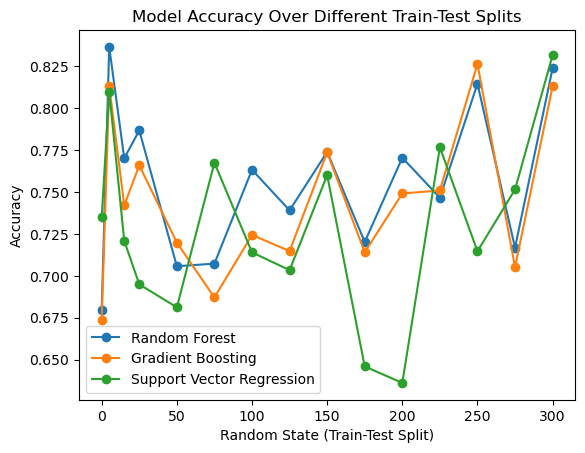

In [582]:
for model_name, accuracies in accuracy_results.items():
    plt.plot(random_states, accuracies, marker='o', label=model_name)

plt.xlabel('Random State (Train-Test Split)')
plt.ylabel('Accuracy')
plt.title('Model Accuracy Over Different Train-Test Splits')
plt.legend()
plt.show()

In [583]:
print(np.array(modelNov18predAvg).mean())

62.35435117279986


In [589]:
bigTest.tickerList

{'AAPL': yfinance.Ticker object <AAPL>,
 'MSFT': yfinance.Ticker object <MSFT>,
 'AMZN': yfinance.Ticker object <AMZN>,
 'GOOG': yfinance.Ticker object <GOOG>,
 'META': yfinance.Ticker object <META>,
 'TSLA': yfinance.Ticker object <TSLA>,
 'JPM': yfinance.Ticker object <JPM>,
 'V': yfinance.Ticker object <V>,
 'NVDA': yfinance.Ticker object <NVDA>,
 'DIS': yfinance.Ticker object <DIS>,
 'NFLX': yfinance.Ticker object <NFLX>,
 'PYPL': yfinance.Ticker object <PYPL>,
 'INTC': yfinance.Ticker object <INTC>,
 'CSCO': yfinance.Ticker object <CSCO>,
 'KO': yfinance.Ticker object <KO>,
 'PFE': yfinance.Ticker object <PFE>,
 'MRK': yfinance.Ticker object <MRK>,
 'WMT': yfinance.Ticker object <WMT>,
 'BAC': yfinance.Ticker object <BAC>,
 'T': yfinance.Ticker object <T>,
 'XOM': yfinance.Ticker object <XOM>,
 'CVX': yfinance.Ticker object <CVX>,
 'ORCL': yfinance.Ticker object <ORCL>,
 'IBM': yfinance.Ticker object <IBM>,
 'NKE': yfinance.Ticker object <NKE>,
 'MCD': yfinance.Ticker object <MCD>